In [1]:
import pandas as pd
pd.set_option('display.max_columns', None) # Show all columns
pd.set_option('display.max_rows', None)      # Limit number of rows shown
pd.set_option('display.width', 1000)       # Width of the display in characters

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
import scipy.stats as stats
import seaborn as sns
from sklearn import linear_model
import statsmodels.api as sm 
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.preprocessing import OneHotEncoder, StandardScaler, OrdinalEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn import tree
import dtreeviz

In [3]:
price = pd.read_csv('Ames_HousePrice.csv')
price.drop(columns=['Unnamed: 0'], inplace=True)
price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,909176150,856,126000,30,RL,NaN,7890,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,0.0,TA,TA,CBlock,TA,TA,No,Rec,238.0,Unf,0.0,618.0,856.0,GasA,TA,Y,SBrkr,856,0,0,1.0,0.0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2.0,399.0,TA,TA,Y,0,0,0,0,166,0,NaN,NaN,NaN,0,3,2010,WD,Normal
1,905476230,1049,139500,120,RL,42.0,4235,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149.0,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552.0,ALQ,393.0,104.0,1049.0,GasA,TA,Y,SBrkr,1049,0,0,1.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1984.0,Fin,1.0,266.0,TA,TA,Y,0,105,0,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal
2,911128020,1001,124900,30,C (all),60.0,6060,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,TA,BrkTil,TA,TA,No,ALQ,737.0,Unf,0.0,100.0,837.0,GasA,Ex,Y,SBrkr,1001,0,0,0.0,0.0,1,0,2,1,Gd,5,Typ,0,NaN,Detchd,1930.0,Unf,1.0,216.0,TA,Po,N,154,0,42,86,0,0,NaN,NaN,NaN,0,11,2007,WD,Normal
3,535377150,1039,114000,70,RL,80.0,8146,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0.0,Unf,0.0,405.0,405.0,GasA,Gd,Y,SBrkr,717,322,0,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1940.0,Unf,1.0,281.0,TA,TA,N,0,0,168,0,111,0,NaN,NaN,NaN,0,5,2009,WD,Normal
4,534177230,1665,227000,60,RL,70.0,8400,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,643.0,Unf,0.0,167.0,810.0,GasA,Ex,Y,SBrkr,810,855,0,1.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,2001.0,Fin,2.0,528.0,TA,TA,Y,0,45,0,0,0,0,NaN,NaN,NaN,0,11,2009,WD,Normal
5,908128060,1922,198500,85,RL,64.0,7301,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500.0,Gd,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Ex,Y,SBrkr,495,1427,0,0.0,0.0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2.0,672.0,TA,TA,Y,0,0,177,0,0,0,NaN,NaN,NaN,0,7,2009,ConLD,Normal
6,902135020,936,93000,20,RM,60.0,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Fa,TA,CBlock,Fa,TA,No,Unf,0.0,Unf,0.0,936.0,936.0,GasA,TA,N,SBrkr,936,0,0,0.0,0.0,1,0,2,1,TA,4,Min2,0,NaN,Detchd,1974.0,Unf,2.0,576.0,TA,TA,Y,0,32,112,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal
7,528228540,1246,187687,20,RL,53.0,3710,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20.0,Gd,TA,PConc,Gd,TA,Gd,Unf,0.0,Unf,0.0,1146.0,1146.0,GasA,Ex,Y,SBrkr,1246,0,0,0.0,0.0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2.0,428.0,TA,TA,Y,100,24,0,0,0,0,NaN,NaN,NaN,0,3,2008,New,Partial
8,923426010,889,137500,20,RL,74.0,12395,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,6,1984,1984,Gable,CompShg,HdBoard,Plywood,NaN,0.0,TA,TA,CBlock,TA,TA,No,ALQ,647.0,Unf,0.0,217.0,864.0,GasA,TA,Y,SBrkr,889,0,0,0.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1984.0,Unf,2.0,484.0,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Normal
9,9081860

In [4]:
columns_to_sum = [
    'PoolArea', 'EnclosedPorch', 'ScreenPorch', 'OpenPorchSF', 'WoodDeckSF',
    '3SsnPorch', 'GarageArea', 'GrLivArea', 'TotalBsmtSF', 'MasVnrArea'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalArea'] = price[columns_to_sum].fillna(0).sum(axis=1)

price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea
0,909176150,856,126000,30,RL,NaN,7890,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,0.0,TA,TA,CBlock,TA,TA,No,Rec,238.0,Unf,0.0,618.0,856.0,GasA,TA,Y,SBrkr,856,0,0,1.0,0.0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2.0,399.0,TA,TA,Y,0,0,0,0,166,0,NaN,NaN,NaN,0,3,2010,WD,Normal,2277.0
1,905476230,1049,139500,120,RL,42.0,4235,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149.0,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552.0,ALQ,393.0,104.0,1049.0,GasA,TA,Y,SBrkr,1049,0,0,1.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1984.0,Fin,1.0,266.0,TA,TA,Y,0,105,0,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal,2618.0
2,911128020,1001,124900,30,C (all),60.0,6060,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,TA,BrkTil,TA,TA,No,ALQ,737.0,Unf,0.0,100.0,837.0,GasA,Ex,Y,SBrkr,1001,0,0,0.0,0.0,1,0,2,1,Gd,5,Typ,0,NaN,Detchd,1930.0,Unf,1.0,216.0,TA,Po,N,154,0,42,86,0,0,NaN,NaN,NaN,0,11,2007,WD,Normal,2336.0
3,535377150,1039,114000,70,RL,80.0,8146,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0.0,Unf,0.0,405.0,405.0,GasA,Gd,Y,SBrkr,717,322,0,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1940.0,Unf,1.0,281.0,TA,TA,N,0,0,168,0,111,0,NaN,NaN,NaN,0,5,2009,WD,Normal,2004.0
4,534177230,1665,227000,60,RL,70.0,8400,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,643.0,Unf,0.0,167.0,810.0,GasA,Ex,Y,SBrkr,810,855,0,1.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,2001.0,Fin,2.0,528.0,TA,TA,Y,0,45,0,0,0,0,NaN,NaN,NaN,0,11,2009,WD,Normal,3048.0
5,908128060,1922,198500,85,RL,64.0,7301,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500.0,Gd,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Ex,Y,SBrkr,495,1427,0,0.0,0.0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2.0,672.0,TA,TA,Y,0,0,177,0,0,0,NaN,NaN,NaN,0,7,2009,ConLD,Normal,3271.0
6,902135020,936,93000,20,RM,60.0,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Fa,TA,CBlock,Fa,TA,No,Unf,0.0,Unf,0.0,936.0,936.0,GasA,TA,N,SBrkr,936,0,0,0.0,0.0,1,0,2,1,TA,4,Min2,0,NaN,Detchd,1974.0,Unf,2.0,576.0,TA,TA,Y,0,32,112,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal,2592.0
7,528228540,1246,187687,20,RL,53.0,3710,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20.0,Gd,TA,PConc,Gd,TA,Gd,Unf,0.0,Unf,0.0,1146.0,1146.0,GasA,Ex,Y,SBrkr,1246,0,0,0.0,0.0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2.0,428.0,TA,TA,Y,100,24,0,0,0,0,NaN,NaN,NaN,0,3,2008,New,Partial,2964.0
8,923426010,889,137500,20,RL,74.0,12395,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,6,1984,1984,Gable,CompShg,HdBoard,Plywood,NaN,0.0,TA,TA,CBlock,TA,TA,No,ALQ,647.0,Unf,0.0,217.0,864.0,GasA,TA,Y,SBrkr,889,0,0,0.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1984.0,Unf,2.0,

In [5]:
columns_to_sum1 = [
    'BsmtFullBath', 'FullBath'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalFullBath'] = price[columns_to_sum1].fillna(0).sum(axis=1)

columns_to_sum2 = [
    'BsmtHalfBath', 'HalfBath'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalHalfBath'] = price[columns_to_sum2].fillna(0).sum(axis=1)

In [6]:
price['Alley'] = price['Alley'].fillna('No Alley Access')
price['MasVnrType'] = price['MasVnrType'].fillna('None')
price['BsmtQual'] = price['BsmtQual'].fillna('No Basement')
price['BsmtCond'] = price['BsmtCond'].fillna('No Basement')
price['BsmtExposure'] = price['BsmtExposure'].fillna('No Basement')
price['BsmtFinType1'] = price['BsmtFinType1'].fillna('No Basement')
price['BsmtFinType2'] = price['BsmtFinType2'].fillna('No Basement')
price['FireplaceQu'] = price['FireplaceQu'].fillna('No Fireplace')
price['GarageType'] = price['GarageType'].fillna('No Garage')
price['GarageYrBlt'] = price['GarageYrBlt'].fillna('No Garage')
price['GarageFinish'] = price['GarageFinish'].fillna('No Garage')
price['GarageQual'] = price['GarageQual'].fillna('No Garage')
price['GarageCond'] = price['GarageCond'].fillna('No Garage')
price['PoolQC'] = price['PoolQC'].fillna('No Pool')
price['Fence'] = price['Fence'].fillna('No Fence')
price['MiscFeature'] = price['MiscFeature'].fillna('None')

In [7]:
price.loc[price['MasVnrType'] == 'None', 'MasVnrArea'] = 0
price.loc[price['BsmtFinType1'] == 'No Basement', 'BsmtFinSF1'] = 0
price.loc[price['BsmtFinType2'] == 'No Basement', 'BsmtFinSF2'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtUnfSF'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'TotalBsmtSF'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtFullBath'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtHalfBath'] = 0
price.loc[price['GarageFinish'] == 'No Garage', 'GarageCars'] = 0
price.loc[price['GarageFinish'] == 'No Garage', 'GarageArea'] = 0

In [8]:
price['MasVnrArea'] = price['MasVnrArea'].fillna(0).astype('int64')
price['BsmtFinSF1'] = price['BsmtFinSF1'].fillna(0).astype('int64')
price['BsmtFinSF2'] = price['BsmtFinSF2'].fillna(0).astype('int64')
price['BsmtUnfSF'] = price['BsmtUnfSF'].fillna(0).astype('int64')
price['TotalBsmtSF'] = price['TotalBsmtSF'].fillna(0).astype('int64')
price['BsmtFullBath'] = price['BsmtFullBath'].fillna(0).astype('int64')
price['GarageCars'] = price['GarageCars'].fillna(0).astype('int64')
price['BsmtHalfBath'] = price['BsmtHalfBath'].fillna(0).astype('int64')
price['GarageArea'] = price['GarageArea'].fillna(0).astype('int64')

In [9]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns

# Fill missing values for categorical and numeric columns
for col in categorical_features:
    mode_val = price[col].mode()[0]
    price[col] = price[col].fillna(mode_val).astype(str)  # ✅ Cast to string

for col in numeric_features:
    price[col] = price[col].fillna(price[col].median())

R²: 0.8140
RSS: 936,708,751,067.14


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros


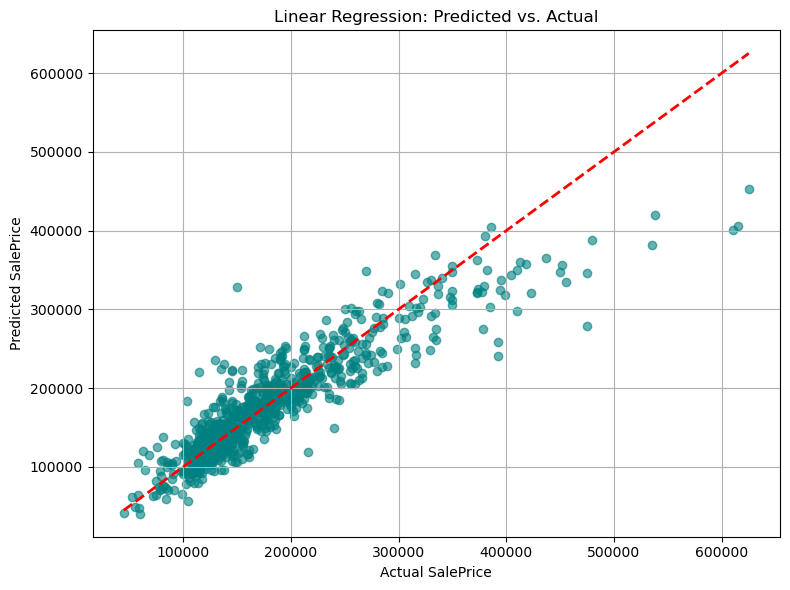

In [10]:
# Define features and target
features = ['TotalArea', 'Neighborhood']
target = 'SalePrice'

# Fill missing values with 0
hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = hood[features]
y = hood[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown = 'ignore'), ['Neighborhood'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', LinearRegression())
])

# Fit model
pipeline.fit(X_train, y_train)

# Predict and evaluate
y_pred = pipeline.predict(X_test)
r2 = r2_score(y_test, y_pred)
rss = np.sum((y_test - y_pred) ** 2)

# Output
print(f"R²: {r2:.4f}")
print(f"RSS: {rss:,.2f}")

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Linear Regression: Predicted vs. Actual')
plt.grid(True)
plt.tight_layout()
plt.show()

/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros


R²: 0.8083
RSS: 608,622,370,247.23


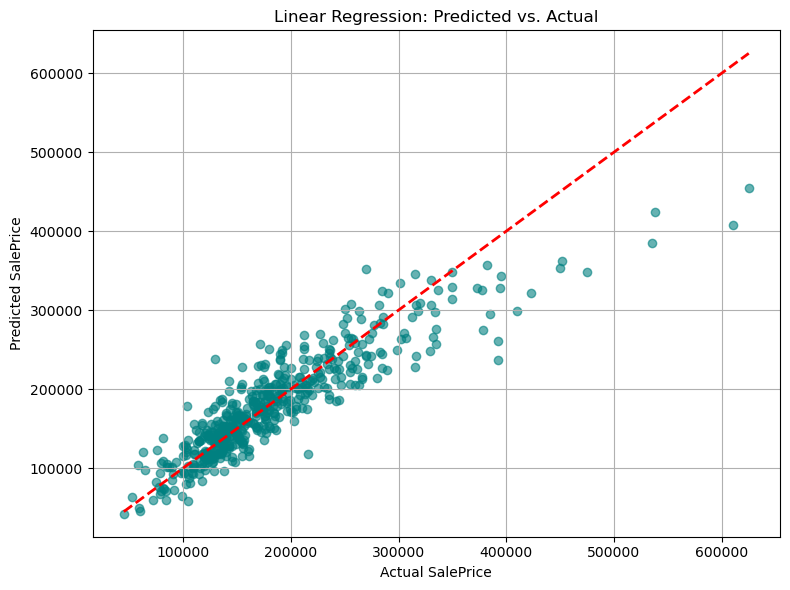

In [11]:
# Define features and target
features = ['TotalArea', 'Neighborhood']
target = 'SalePrice'

# Fill missing values with 0
hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = hood[features]
y = hood[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown = 'ignore'), ['Neighborhood'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', LinearRegression())
])

# Fit model
pipeline.fit(X_train, y_train)

# Predict and evaluate
y_pred = pipeline.predict(X_test)
r2 = r2_score(y_test, y_pred)
rss = np.sum((y_test - y_pred) ** 2)

# Output
print(f"R²: {r2:.4f}")
print(f"RSS: {rss:,.2f}")

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Linear Regression: Predicted vs. Actual')
plt.grid(True)
plt.tight_layout()
plt.show()

R²: 0.8072
RSS: 612,143,097,009.32


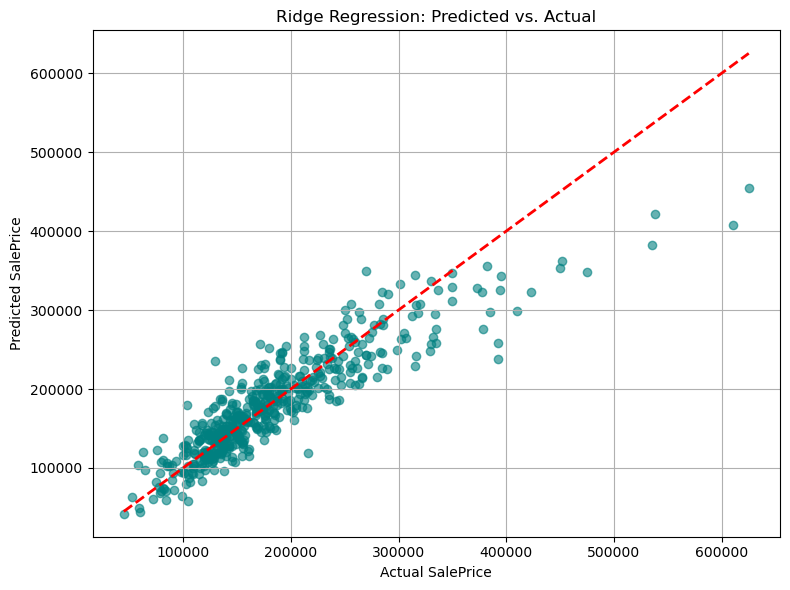

In [12]:
# Select variables
features = ['TotalArea', 'Neighborhood']
target = 'SalePrice'

multi_feats = price[features + [target]].fillna(0)

# Define X and y
X = multi_feats[features]
y = multi_feats[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea']),
        ('cat', categorical_transformer, ['Neighborhood'])
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

ridge_pipeline = Pipeline([
    ('prep', preprocessor),  # Add preprocessing step
    ('reg', Ridge(alpha=1.0))
])



# Fit and evaluate on full data
ridge_pipeline.fit(X_train, y_train)
y_pred_ridge = ridge_pipeline.predict(X_test)
r2_ridge = r2_score(y_test, y_pred_ridge)
rss_ridge = np.sum((y_test - y_pred_ridge) ** 2)

print(f"R²: {r2_ridge:.4f}")
print(f"RSS: {rss_ridge:,.2f}")

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_ridge, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Ridge Regression: Predicted vs. Actual')
plt.grid(True)
plt.tight_layout()
plt.show()

R²: 0.8089
RSS: 606,544,045,311.28


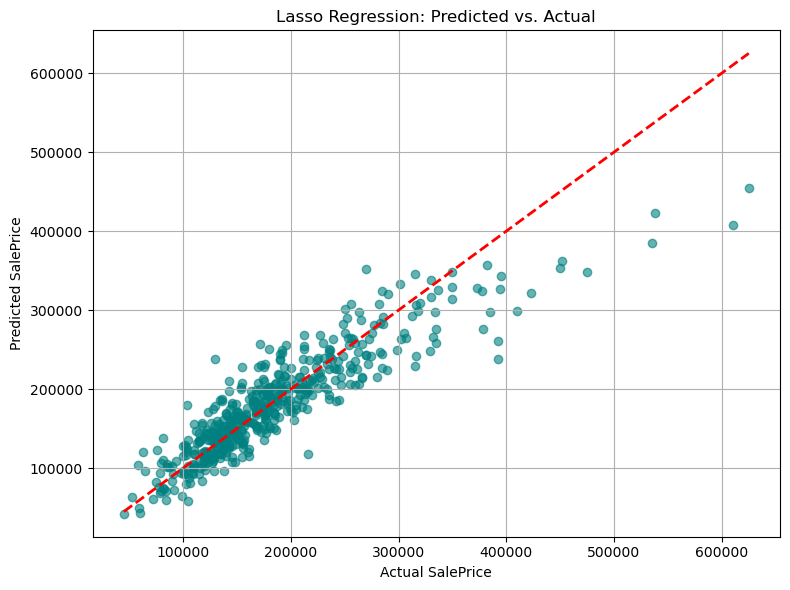

In [13]:
# Select variables
features = ['TotalArea', 'Neighborhood']
target = 'SalePrice'

multi_feats = price[features + [target]].fillna(0)

# Define X and y
X = multi_feats[features]
y = multi_feats[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea']),
        ('cat', categorical_transformer, ['Neighborhood'])
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

lasso_pipeline = Pipeline([
    ('prep', preprocessor),  # Add this step
    ('reg', Lasso(alpha=0.1, max_iter=10000))
])

# Fit and evaluate on full data
lasso_pipeline.fit(X_train, y_train)
y_pred_lasso = lasso_pipeline.predict(X_test)
r2_lasso = r2_score(y_test, y_pred_lasso)
rss_lasso = np.sum((y_test - y_pred_lasso) ** 2)

print(f"R²: {r2_lasso:.4f}")
print(f"RSS: {rss_lasso:,.2f}")

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_lasso, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Lasso Regression: Predicted vs. Actual')
plt.grid(True)
plt.tight_layout()
plt.show()

R²: 0.8140
RSS: 936,708,751,067.14


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros


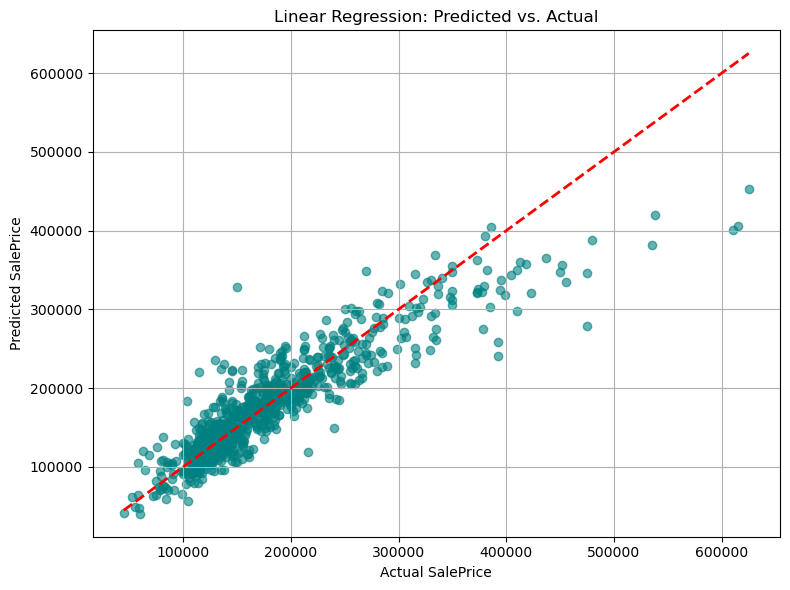

In [14]:
### CREATE DECISION TREE OR RANDOM FOREST

# Define features and target
features = ['TotalArea', 'Neighborhood']
target = 'SalePrice'

# Fill missing values with 0
hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = hood[features]
y = hood[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown = 'ignore'), ['Neighborhood'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', LinearRegression())
])

# Fit model
pipeline.fit(X_train, y_train)

# Predict and evaluate
y_pred = pipeline.predict(X_test)
r2 = r2_score(y_test, y_pred)
rss = np.sum((y_test - y_pred) ** 2)

# Output
print(f"R²: {r2:.4f}")
print(f"RSS: {rss:,.2f}")

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Linear Regression: Predicted vs. Actual')
plt.grid(True)
plt.tight_layout()
plt.show()

R²: 0.8943
RSS: 532,659,638,158.39


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 8, 14] during transform. These unknown categories will be encoded as all zeros


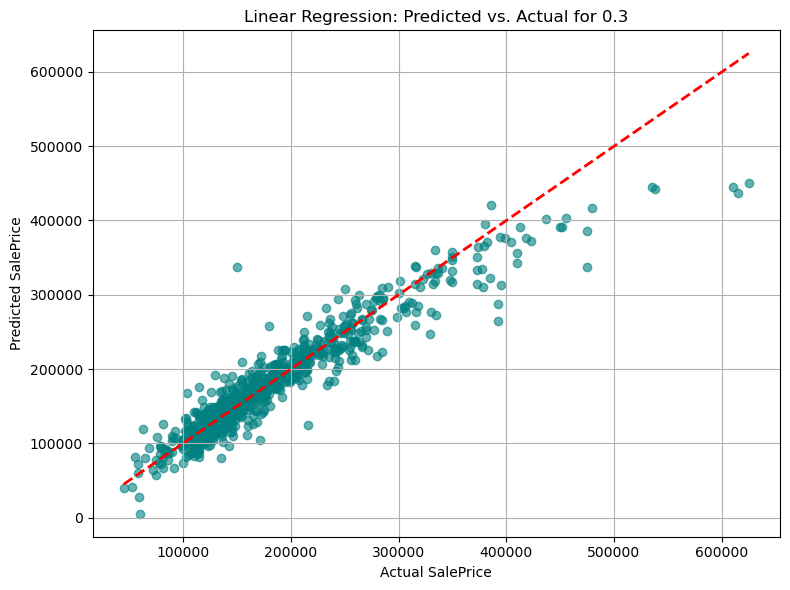

In [15]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 'Foundation', 
            'OverallQual', 'TotalFullBath', 'TotalHalfBath', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 
            'LotConfig', 'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 'CentralAir',
            'KitchenQual', 'SaleType']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 
                                              'Foundation', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 'LotConfig', 
                                              'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 
                                              'CentralAir', 'KitchenQual', 'SaleType'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', LinearRegression())
])

# Fit model
pipeline.fit(X_train, y_train)

# Predict and evaluate
y_pred = pipeline.predict(X_test)
r2 = r2_score(y_test, y_pred)
rss = np.sum((y_test - y_pred) ** 2)

# Output
print(f"R²: {r2:.4f}")
print(f"RSS: {rss:,.2f}")

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Linear Regression: Predicted vs. Actual for 0.3')
plt.grid(True)
plt.tight_layout()
plt.show()

In [16]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 'Foundation', 
            'OverallQual', 'TotalFullBath', 'TotalHalfBath', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 
            'LotConfig', 'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 'CentralAir',
            'KitchenQual', 'SaleType']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 
                                              'Foundation', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 'LotConfig', 
                                              'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 
                                              'CentralAir', 'KitchenQual', 'SaleType'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', LinearRegression())
])

# Fit model
pipeline.fit(X_train, y_train)

# Predict and evaluate
y_pred = pipeline.predict(X_test)
r2 = r2_score(y_test, y_pred)
rss = np.sum((y_test - y_pred) ** 2)

# Output
print(f"R²: {r2:.4f}")
print(f"RSS: {rss:,.2f}")

R²: 0.8929
RSS: 339,914,545,061.74


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0, 8, 14] during transform. These unknown categories will be encoded as all zeros


R²: 0.8905
RSS: 347,592,747,134.55


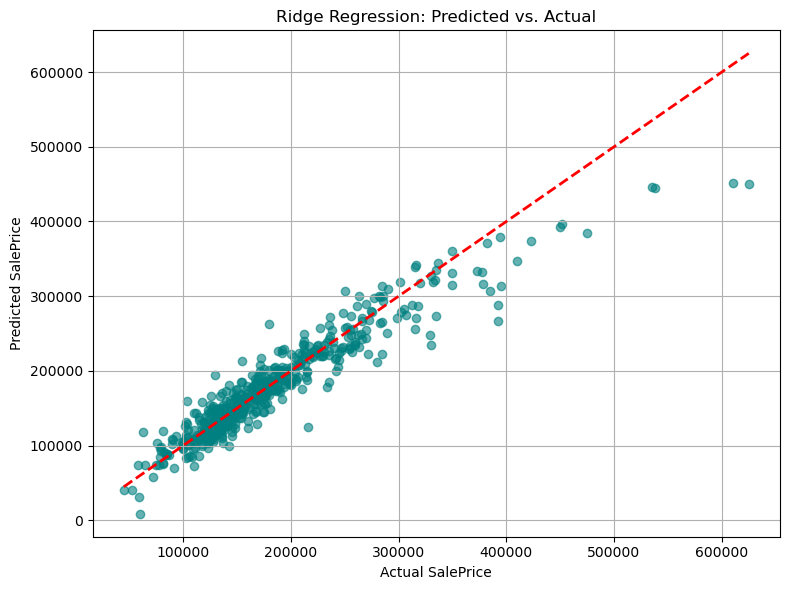

In [17]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 'Foundation', 
            'OverallQual', 'TotalFullBath', 'TotalHalfBath', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 
            'LotConfig', 'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 'CentralAir',
            'KitchenQual', 'SaleType']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea', 'OverallQual', 'TotalFullBath', 'TotalHalfBath']),
        ('cat', categorical_transformer, ['Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 
                                          'Foundation', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 'LotConfig', 
                                          'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 
                                          'CentralAir', 'KitchenQual', 'SaleType'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Ridge pipeline
ridge_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Ridge(alpha=1.0))
])

# Fit and evaluate on full data
ridge_pipeline.fit(X_train, y_train)
y_pred_ridge = ridge_pipeline.predict(X_test)
r2_ridge = r2_score(y_test, y_pred_ridge)
rss_ridge = np.sum((y_test - y_pred_ridge) ** 2)

print(f"R²: {r2_ridge:.4f}")
print(f"RSS: {rss_ridge:,.2f}")

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_ridge, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Ridge Regression: Predicted vs. Actual')
plt.grid(True)
plt.tight_layout()
plt.show()

R²: 0.8922
RSS: 342,159,160,173.16


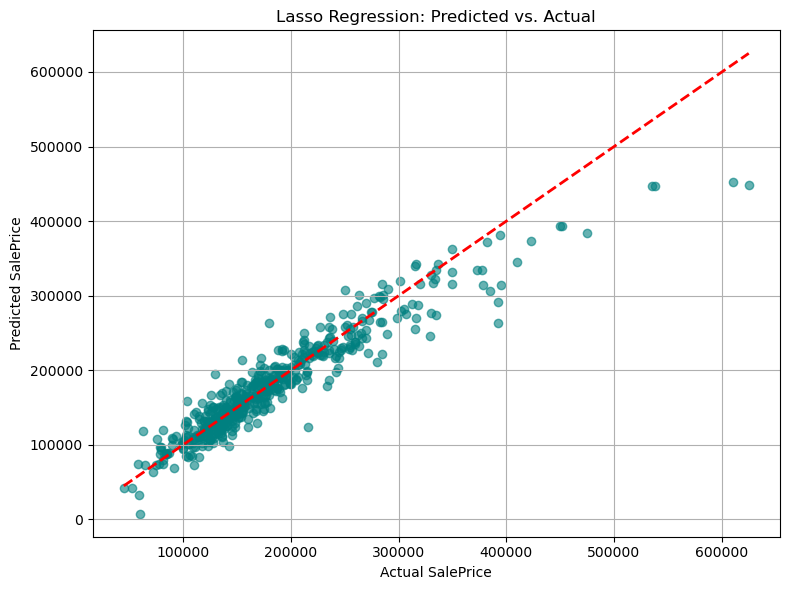

In [18]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 'Foundation', 
            'OverallQual', 'TotalFullBath', 'TotalHalfBath', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 
            'LotConfig', 'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 'CentralAir',
            'KitchenQual', 'SaleType']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea', 'OverallQual', 'TotalFullBath', 'TotalHalfBath']),
        ('cat', categorical_transformer, ['Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 
                                          'Foundation', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 'LotConfig', 
                                          'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 
                                          'CentralAir', 'KitchenQual', 'SaleType'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Lasso pipeline
lasso_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Lasso(alpha=0.1, max_iter=10000))
])

# Fit and evaluate on full data
lasso_pipeline.fit(X_train, y_train)
y_pred_lasso = lasso_pipeline.predict(X_test)
r2_lasso = r2_score(y_test, y_pred_lasso)
rss_lasso = np.sum((y_test - y_pred_lasso) ** 2)

print(f"R²: {r2_lasso:.4f}")
print(f"RSS: {rss_lasso:,.2f}")

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_lasso, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Lasso Regression: Predicted vs. Actual')
plt.grid(True)
plt.tight_layout()
plt.show()

In [19]:
# Define what counts as a finished basement
finished_basement_types = ['GLQ', 'ALQ', 'BLQ', 'Rec', 'LwQ']

# Create new total room feature including finished basement types
price['TotalFinishedRooms'] = (
    price['TotRmsAbvGrd'] +
    price['BsmtFinType1'].apply(lambda x: 1 if x in finished_basement_types else 0) +
    price['BsmtFinType2'].apply(lambda x: 1 if x in finished_basement_types else 0)
)

price['TotalBathrooms'] = (
    price['FullBath'].fillna(0) +
    price['HalfBath'].fillna(0) * 0.5 +
    price['BsmtFullBath'].fillna(0) +
    price['BsmtHalfBath'].fillna(0) * 0.5
)

price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea,TotalFullBath,TotalHalfBath,TotalFinishedRooms,TotalBathrooms
0,909176150,856,126000,30,RL,68.0,7890,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0,TA,TA,CBlock,TA,TA,No,Rec,238,Unf,0,618,856,GasA,TA,Y,SBrkr,856,0,0,1,0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2,399,TA,TA,Y,0,0,0,0,166,0,No Pool,No Fence,None,0,3,2010,WD,Normal,2277.0,2.0,0.0,5,2.0
1,905476230,1049,139500,120,RL,42.0,4235,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552,ALQ,393,104,1049,GasA,TA,Y,SBrkr,1049,0,0,1,0,2,0,2,1,Gd,5,Typ,0,No Fireplace,Attchd,1984.0,Fin,1,266,TA,TA,Y,0,105,0,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2618.0,3.0,0.0,7,3.0
2,911128020,1001,124900,30,C (all),60.0,6060,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,None,0,Gd,TA,BrkTil,TA,TA,No,ALQ,737,Unf,0,100,837,GasA,Ex,Y,SBrkr,1001,0,0,0,0,1,0,2,1,Gd,5,Typ,0,No Fireplace,Detchd,1930.0,Unf,1,216,TA,Po,N,154,0,42,86,0,0,No Pool,No Fence,None,0,11,2007,WD,Normal,2336.0,1.0,0.0,6,1.0
3,535377150,1039,114000,70,RL,80.0,8146,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,None,0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0,Unf,0,405,405,GasA,Gd,Y,SBrkr,717,322,0,0,0,1,0,2,1,TA,6,Typ,0,No Fireplace,Detchd,1940.0,Unf,1,281,TA,TA,N,0,0,168,0,111,0,No Pool,No Fence,None,0,5,2009,WD,Normal,2004.0,1.0,0.0,6,1.0
4,534177230,1665,227000,60,RL,70.0,8400,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,None,0,Gd,TA,PConc,Gd,TA,No,GLQ,643,Unf,0,167,810,GasA,Ex,Y,SBrkr,810,855,0,1,0,2,1,3,1,Gd,6,Typ,0,No Fireplace,Attchd,2001.0,Fin,2,528,TA,TA,Y,0,45,0,0,0,0,No Pool,No Fence,None,0,11,2009,WD,Normal,3048.0,3.0,1.0,7,3.5
5,908128060,1922,198500,85,RL,64.0,7301,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500,Gd,TA,Slab,No Basement,No Basement,No Basement,No Basement,0,No Basement,0,0,0,GasA,Ex,Y,SBrkr,495,1427,0,0,0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2,672,TA,TA,Y,0,0,177,0,0,0,No Pool,No Fence,None,0,7,2009,ConLD,Normal,3271.0,3.0,0.0,7,3.0
6,902135020,936,93000,20,RM,60.0,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,None,0,Fa,TA,CBlock,Fa,TA,No,Unf,0,Unf,0,936,936,GasA,TA,N,SBrkr,936,0,0,0,0,1,0,2,1,TA,4,Min2,0,No Fireplace,Detchd,1974.0,Unf,2,576,TA,TA,Y,0,32,112,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2592.0,1.0,0.0,4,1.0
7,528228540,1246,187687,20,RL,53.0,3710,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20,Gd,TA,PConc,Gd,TA,Gd,Unf,0,Unf,0,1146,1146,GasA,Ex,Y,SBrkr,1246,0,0,0,0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2,428,TA,TA,Y,100,24,0,0,0,0,No Pool,No Fence,None,0,3,2008,New,Partial,2964.0,2.0,0.0,5,2.0
8

R²: 0.8977
RSS: 515,385,855,961.41


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros


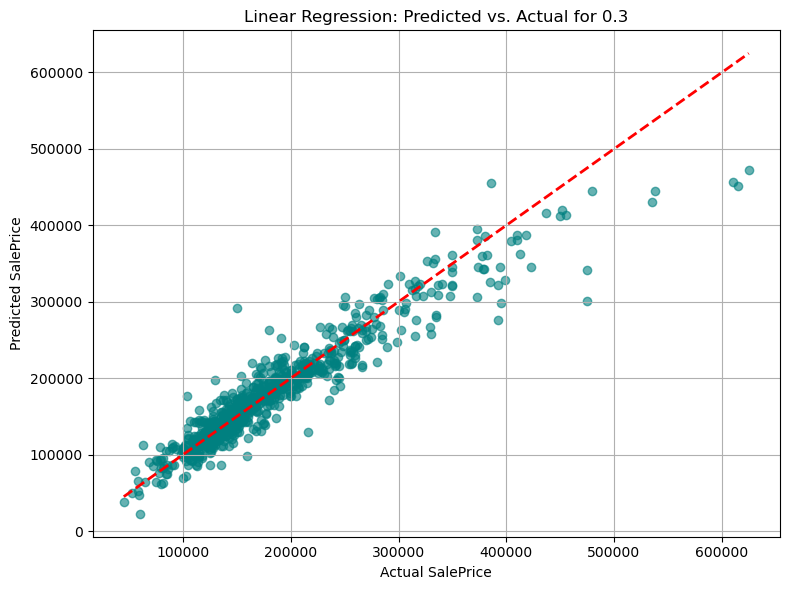

In [20]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'FireplaceQu', 
            'TotRmsAbvGrd', 'OverallQual', 'OverallCond', 'TotalHalfBath', 'ExterQual', 'BsmtQual', 
            'BsmtExposure', 'TotalFullBath']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass',
                                              'FireplaceQu', 'ExterQual', 'BsmtQual', 'BsmtExposure'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', LinearRegression())
])

# Fit model
pipeline.fit(X_train, y_train)

# Predict and evaluate
y_pred = pipeline.predict(X_test)
r2 = r2_score(y_test, y_pred)
rss = np.sum((y_test - y_pred) ** 2)

# Output
print(f"R²: {r2:.4f}")
print(f"RSS: {rss:,.2f}")

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Linear Regression: Predicted vs. Actual for 0.3')
plt.grid(True)
plt.tight_layout()
plt.show()

In [21]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'FireplaceQu', 
            'TotRmsAbvGrd', 'OverallQual', 'OverallCond', 'TotalHalfBath', 'ExterQual', 'BsmtQual', 
            'BsmtExposure', 'TotalFullBath']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass',
                                              'FireplaceQu', 'ExterQual', 'BsmtQual', 'BsmtExposure'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', LinearRegression())
])

# Fit model
pipeline.fit(X_train, y_train)

# Predict and evaluate
y_pred = pipeline.predict(X_test)
r2 = r2_score(y_test, y_pred)
rss = np.sum((y_test - y_pred) ** 2)

# Output
print(f"R²: {r2:.4f}")
print(f"RSS: {rss:,.2f}")

R²: 0.8945
RSS: 334,964,405,767.52


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros


R²: 0.8945
RSS: 334,964,405,767.52


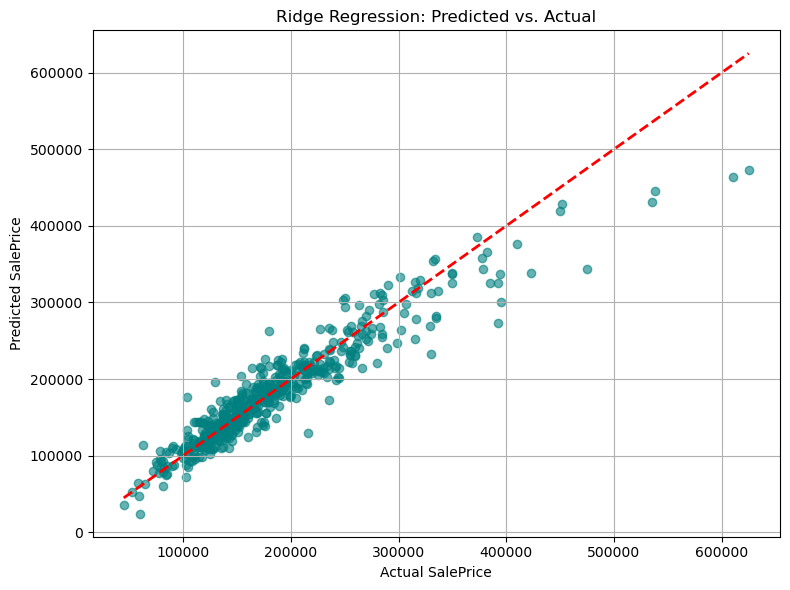

In [22]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'FireplaceQu', 
            'TotRmsAbvGrd', 'OverallQual', 'OverallCond', 'TotalHalfBath', 'ExterQual', 'BsmtQual', 
            'BsmtExposure', 'TotalFullBath']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea', 'OverallQual', 'TotalFullBath', 'TotalHalfBath']),
        ('cat', categorical_transformer, ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass',
                                          'FireplaceQu', 'ExterQual', 'BsmtQual', 'BsmtExposure'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Ridge pipeline
ridge_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Ridge(alpha=1.0))
])

# Fit and evaluate on full data
ridge_pipeline.fit(X_train, y_train)
y_pred_ridge = ridge_pipeline.predict(X_test)
r2_ridge = r2_score(y_test, y_pred_ridge)
rss_ridge = np.sum((y_test - y_pred_ridge) ** 2)

# Output
print(f"R²: {r2:.4f}")
print(f"RSS: {rss:,.2f}")

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_ridge, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Ridge Regression: Predicted vs. Actual')
plt.grid(True)
plt.tight_layout()
plt.show()

R² (Lasso on full data): 0.8957
RSS: 330,926,540,437.74


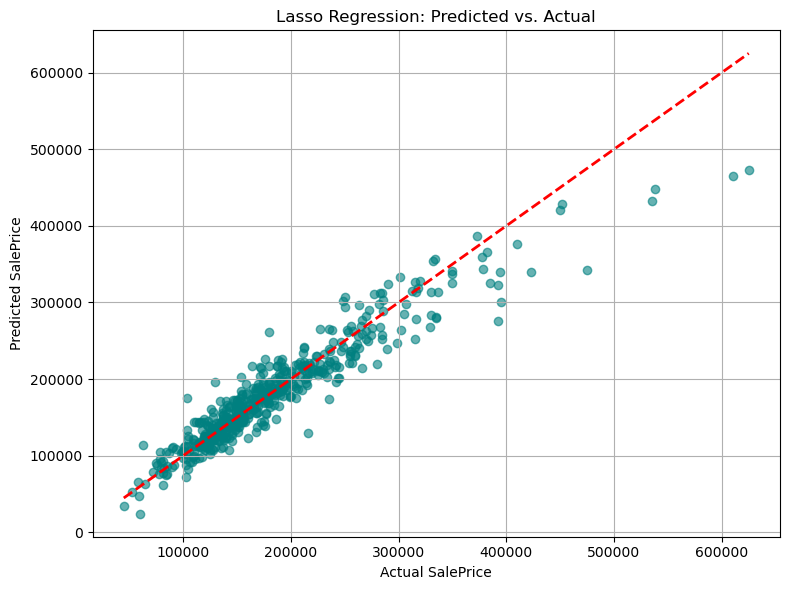

In [23]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'FireplaceQu', 
            'TotRmsAbvGrd', 'OverallQual', 'OverallCond', 'TotalHalfBath', 'ExterQual', 'BsmtQual', 
            'BsmtExposure', 'TotalFullBath']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea', 'TotRmsAbvGrd', 'OverallQual', 'OverallCond', 
                                      'TotalHalfBath', 'TotalFullBath']),
        ('cat', categorical_transformer, ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass',
                                          'FireplaceQu', 'ExterQual', 'BsmtQual', 'BsmtExposure'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

lasso_pipeline = Pipeline([
    ('prep', preprocessor),  # Add this step
    ('reg', Lasso(alpha=0.1, max_iter=10000))
])

# Fit and evaluate on full data
lasso_pipeline.fit(X_train, y_train)
y_pred_lasso = lasso_pipeline.predict(X_test)
r2_lasso = r2_score(y_test, y_pred_lasso)
rss_lasso = np.sum((y_test - y_pred_lasso) ** 2)

print(f"R² (Lasso on full data): {r2_lasso:.4f}")
print(f"RSS: {rss_lasso:,.2f}")

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_lasso, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Lasso Regression: Predicted vs. Actual')
plt.grid(True)
plt.tight_layout()
plt.show()

Fitting 5 folds for each of 20 candidates, totalling 100 fits
R²: 0.9172
RSS: 262,740,812,062.28


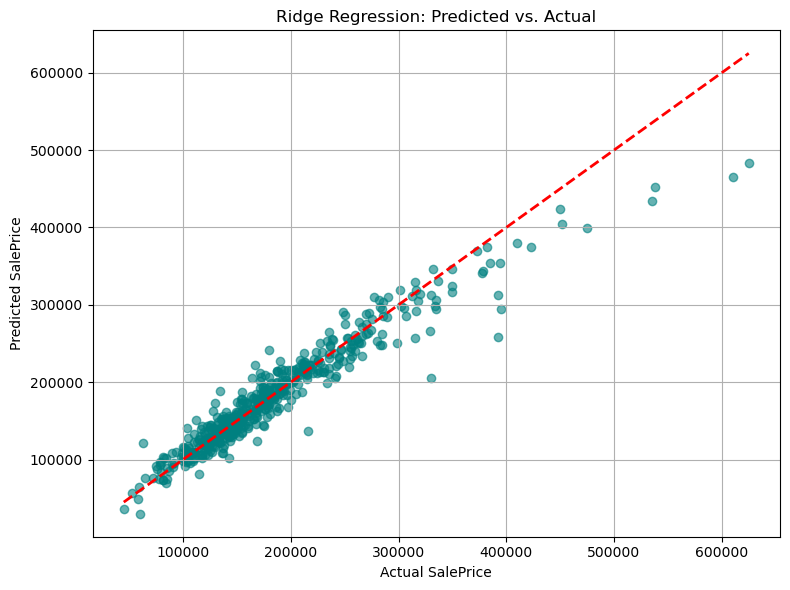

In [24]:
X = price[numeric_features.tolist() + categorical_features.tolist()]
 
# Target variable
y = price['SalePrice']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
 
# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for both numeric and categorical data
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Ridge pipeline
ridge_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Ridge())
])

# Grid search over alphas
alpha_range = list(range(1, 21))
ridge_grid = GridSearchCV(estimator=ridge_pipeline,
                          param_grid={'reg__alpha': alpha_range},
                          cv=5,
                          scoring='r2',
                          verbose=1)

ridge_grid.fit(X_train, y_train)

# Best results
best_ridge = ridge_grid.best_estimator_
best_alpha = ridge_grid.best_params_['reg__alpha']
best_cv_score = ridge_grid.best_score_

# Predict and evaluate on full data
y_pred_ridge = best_ridge.predict(X_test)
r2_ridge = r2_score(y_test, y_pred_ridge)
rss_ridge = np.sum((y_test - y_pred_ridge) ** 2)


print(f"R²: {r2_ridge:.4f}")
print(f"RSS: {rss_ridge:,.2f}")


# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_ridge, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Ridge Regression: Predicted vs. Actual')
plt.grid(True)
plt.tight_layout()
plt.show()

Fitting 5 folds for each of 20 candidates, totalling 100 fits


/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 213133212678.86005, tolerance: 862075625.0031394
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 237184057616.2629, tolerance: 902201188.9960424
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 238107337474.35507, tolerance: 891219679.9618819
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 173943814152.14478, tolera

R²: 0.9102
RSS: 285,028,816,100.35


/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 111143950345.14294, tolerance: 1132935533.4430199


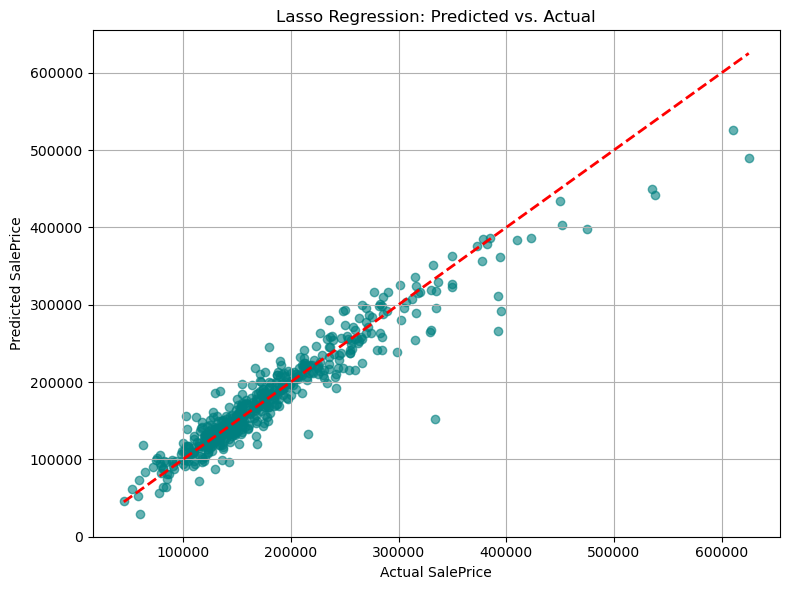

In [25]:
X = price[numeric_features.tolist() + categorical_features.tolist()]
 
# Target variable
y = price['SalePrice']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
 
# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for both numeric and categorical data
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Lasso pipeline
lasso_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Lasso(max_iter = 5000))
])

# Grid search over alphas
alpha_range = np.linspace(0.001, 1, 20)
lasso_grid = GridSearchCV(
    estimator=lasso_pipeline,
    param_grid={'reg__alpha': alpha_range},
    cv=5,
    scoring='r2',
    verbose=1
)

lasso_grid.fit(X_train, y_train)

# Best results
lasso_best_model = lasso_grid.best_estimator_
lasso_best_alpha = lasso_grid.best_params_['reg__alpha']
lasso_best_score = lasso_grid.best_score_

# Fit and evaluate on full data
y_pred_lasso = lasso_best_model.predict(X_test)
r2_lasso = r2_score(y_test, y_pred_lasso)
rss_lasso = np.sum((y_test - y_pred_lasso) ** 2)


print(f"R²: {r2_lasso:.4f}")
print(f"RSS: {rss_lasso:,.2f}")


# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_lasso, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Lasso Regression: Predicted vs. Actual')
plt.grid(True)
plt.tight_layout()
plt.show()

In [26]:
mode_val = price['Electrical'].mode(dropna=True)[0] 
price['Electrical'] = price['Electrical'].fillna(mode_val)

# Fill missing values for categorical and numeric columns
for col in categorical_features:
    mode_val = price[col].mode()[0]
    price[col] = price[col].fillna(mode_val).astype(str)  # ✅ Cast to string

for col in numeric_features:
    price[col] = price[col].fillna(price[col].median())

In [27]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import FunctionTransformer

# Manually specify the categories for ordinal encoding according to the data dictionary
ordinal_order = {
    'Electrical': ['Mix', 'FuseP', 'FuseF', 'FuseA', 'SBrkr'],  # Electrical system
    'LotShape': ['IR3', 'IR2', 'IR1', 'Reg'],  # General shape of property
    'Utilities': ['ELO', 'NoSeWa', 'NoSewr', 'AllPub'],  # Type of utilities available
    'LandSlope': ['Sev', 'Mod', 'Gtl'],  # Slope of property
    'ExterQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the quality of the material on the exterior
    'ExterCond': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the present condition of the material on the exterior
    'BsmtQual': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Height of the basement
    'BsmtCond': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # General condition of the basement
    'BsmtExposure': ['No Basement', 'No', 'Mn', 'Av', 'Gd'],  # Walkout or garden level basement walls
    'BsmtFinType1': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of basement finished area
    'BsmtFinType2': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of second basement finished area
    'HeatingQC': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Heating quality and condition
    'KitchenQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Kitchen quality
    'Functional': ['Sal', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ'],  # Home functionality
    'FireplaceQu': ['No Fireplace', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Fireplace quality
    'GarageFinish': ['No Garage', 'Unf', 'RFn', 'Fin'],  # Interior finish of the garage
    'GarageQual': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage quality
    'GarageCond': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage condition
    'PavedDrive': ['N', 'P', 'Y'],  # Paved driveway
    'PoolQC': ['No Pool', 'Fa', 'TA', 'Gd', 'Ex'],  # Pool quality
    'Fence': ['No Fence', 'MnWw', 'GdWo', 'MnPrv', 'GdPrv']  # Fence quality
}

# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())

# List of ordinal features except Electrical
ordinal_except_electrical = [feature for feature in ordinal_features if feature != 'Electrical']

# Specific transformer for 'Electrical' using the mode for imputation
electrical_imputer = Pipeline(steps=[
    ('impute_electrical', SimpleImputer(strategy='most_frequent'))
])

# Helper function to fill 'None' for other ordinal features
def fill_none(X):
    return X.fillna("None")

# Pipeline for ordinal features: Fill missing values with 'None'
ordinal_imputer = Pipeline(steps=[
    ('fill_none', FunctionTransformer(fill_none, validate=False))
])

# Preprocessor for filling missing values
preprocessor_fill = ColumnTransformer(transformers=[
    ('electrical', electrical_imputer, ['Electrical']),
    ('cat', ordinal_imputer, ordinal_except_electrical)
])

# Apply preprocessor for filling missing values
Ames_ordinal = preprocessor_fill.fit_transform(price[ordinal_features])

# Convert back to DataFrame to apply OrdinalEncoder
Ames_ordinal = pd.DataFrame(Ames_ordinal, columns=['Electrical'] + ordinal_except_electrical)

# Apply Ordinal Encoding
categories = [ordinal_order[feature] for feature in ordinal_features]
ordinal_encoder = OrdinalEncoder(categories=categories)
Ames_ordinal_encoded = ordinal_encoder.fit_transform(Ames_ordinal)
Ames_ordinal_encoded = pd.DataFrame(Ames_ordinal_encoded, columns=['Electrical'] + ordinal_except_electrical)

In [28]:
Ames_ordinal_encoded

,Electrical,LotShape,Utilities,LandSlope,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,HeatingQC,KitchenQual,Functional,FireplaceQu,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence
0,4.0,3.0,3.0,2.0,2.0,2.0,3.0,3.0,1.0,3.0,1.0,2.0,2.0,7.0,4.0,1.0,3.0,3.0,2.0,0.0,0.0
1,4.0,3.0,3.0,2.0,3.0,2.0,4.0,3.0,2.0,6.0,5.0,2.0,3.0,7.0,0.0,3.0,3.0,3.0,2.0,0.0,0.0
2,4.0,3.0,3.0,2.0,3.0,2.0,3.0,3.0,1.0,5.0,1.0,4.0,3.0,7.0,0.0,1.0,3.0,1.0,0.0,0.0,0.0
3,4.0,3.0,3.0,2.0,3.0,3.0,2.0,3.0,1.0,1.0,1.0,3.0,2.0,7.0,0.0,1.0,3.0,3.0,0.0,0.0,0.0
4,4.0,3.0,3.0,2.0,3.0,2.0,4.0,3.0,1.0,6.0,1.0,4.0,3.0,7.0,0.0,3.0,3.0,3.0,2.0,0.0,0.0
5,4.0,3.0,3.0,2.0,3.0,2.0,0.0,0.0,0.0,0.0,0.0,4.0,3.0,7.0,5.0,2.0,3.0,3.0,2.0,0.0,0.0
6,4.0,3.0,3.0,1.0,1.0,2.0,2.0,3.0,1.0,1.0,1.0,2.0,2.0,5.0,0.0,1.0,3.0,3.0,2.0,0.0,0.0
7,4.0,3.0,3.0,2.0,3.0,2.0,4.0,3.0,4.0,1.0,1.0,4.0,3.0,7.0,4.0,3.0,3.0,3.0,2.0,0.0,0.0
8,4.0,3.0,3.0,2.0,2.0,2.0,3.0,3.0,1.0,5.0,1.0,2.0,2.0,7.0,0.0,1.0,3.0,3.0,2.0,0.0,0.0
9,4.0,3.0,3.0,2.0,2.0,2.0,4.0,3.0,4.0,6.0,1.0,4.0,3.0,7.0,0.0,3.0,3.0,3.0,2.0,0.0,0.0


In [72]:
# Load and split the data
X_ordinal = Ames_ordinal_encoded # Use only the ordinal features for fitting the model
y = price['SalePrice']
X_train, X_test, y_train, y_test = train_test_split(X_ordinal, y, test_size=0.2, random_state=42)

# Initialize and fit the Decision Tree
tree_model = DecisionTreeRegressor(max_depth=3)
tree_model.fit(X_train.values, y_train)

# Visualize the decision tree using dtreeviz
viz = dtreeviz.model(tree_model, X_train, y_train,
               target_name='SalePrice', feature_names=X_train.columns.tolist())

# In Jupyter Notebook, you can directly view the visual using the below:
# viz.view()  # Renders and displays the SVG visualization

# In PyCharm, you can render and display the SVG image:
v = viz.view()     # render as SVG into internal object
v.show()           # pop up window

In [74]:
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns.difference(['Electrical'])
electrical_feature = ['Electrical']

# Manually specify the categories for ordinal encoding according to the data dictionary
ordinal_order = {
    'Electrical': ['Mix', 'FuseP', 'FuseF', 'FuseA', 'SBrkr'],  # Electrical system
    'LotShape': ['IR3', 'IR2', 'IR1', 'Reg'],  # General shape of property
    'Utilities': ['ELO', 'NoSeWa', 'NoSewr', 'AllPub'],  # Type of utilities available
    'LandSlope': ['Sev', 'Mod', 'Gtl'],  # Slope of property
    'ExterQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the quality of the material on the exterior
    'ExterCond': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the present condition of the material on the exterior
    'BsmtQual': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Height of the basement
    'BsmtCond': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # General condition of the basement
    'BsmtExposure': ['No Basement', 'No', 'Mn', 'Av', 'Gd'],  # Walkout or garden level basement walls
    'BsmtFinType1': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of basement finished area
    'BsmtFinType2': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of second basement finished area
    'HeatingQC': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Heating quality and condition
    'KitchenQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Kitchen quality
    'Functional': ['Sal', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ'],  # Home functionality
    'FireplaceQu': ['No Fireplace', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Fireplace quality
    'GarageFinish': ['No Garage', 'Unf', 'RFn', 'Fin'],  # Interior finish of the garage
    'GarageQual': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage quality
    'GarageCond': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage condition
    'PavedDrive': ['N', 'P', 'Y'],  # Paved driveway
    'PoolQC': ['No Pool', 'Fa', 'TA', 'Gd', 'Ex'],  # Pool quality
    'Fence': ['No Fence', 'MnWw', 'GdWo', 'MnPrv', 'GdPrv']  # Fence quality
}

# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())

# List of ordinal features except Electrical
ordinal_except_electrical = [feature for feature in ordinal_features if feature != 'Electrical']

# Specific transformer for 'Electrical' using the mode for imputation
electrical_imputer = Pipeline(steps=[
    ('impute_electrical', SimpleImputer(strategy='most_frequent'))
])

# Helper function to fill 'None' for other ordinal features
def fill_none(X):
    return X.fillna("None")

# Pipeline for ordinal features: Fill missing values with 'None'
ordinal_imputer = Pipeline(steps=[
    ('fill_none', FunctionTransformer(fill_none, validate=False))
])

# Preprocessor for filling missing values
preprocessor_fill = ColumnTransformer(transformers=[
    ('electrical', electrical_imputer, ['Electrical']),
    ('cat', ordinal_imputer, ordinal_except_electrical)
])

# Apply preprocessor for filling missing values
Ames_ordinal = preprocessor_fill.fit_transform(price[ordinal_features])

# Convert back to DataFrame to apply OrdinalEncoder
Ames_ordinal = pd.DataFrame(Ames_ordinal, columns=['Electrical'] + ordinal_except_electrical)

# Apply Ordinal Encoding
categories = [ordinal_order[feature] for feature in ordinal_features]
ordinal_encoder = OrdinalEncoder(categories=categories)
Ames_ordinal_encoded = ordinal_encoder.fit_transform(Ames_ordinal)
Ames_ordinal_encoded = pd.DataFrame(Ames_ordinal_encoded, columns=['Electrical'] + ordinal_except_electrical)

In [76]:
# Load and split the data

X_ordinal = pd.concat([Ames_ordinal_encoded, price[numeric_features]], axis = 1) # Use only the ordinal features for fitting the model
y = price['SalePrice']
X_train, X_test, y_train, y_test = train_test_split(X_ordinal, y, test_size=0.2, random_state=42)

# Initialize and fit the Decision Tree
tree_model = DecisionTreeRegressor(max_depth=3)
tree_model.fit(X_train.values, y_train)

# Visualize the decision tree using dtreeviz
viz = dtreeviz.model(tree_model, X_train, y_train,
               target_name='SalePrice', feature_names=X_train.columns.tolist())

# In Jupyter Notebook, you can directly view the visual using the below:
# viz.view()  # Renders and displays the SVG visualization

# In PyCharm, you can render and display the SVG image:
v = viz.view()     # render as SVG into internal object
v.show()           # pop up window

In [32]:
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice', 'TotalArea', 
                                                                                   'TotalFullBath', 'TotalHalfBath', 
                                                                                   'TotalBathrooms']).columns


# Manually specify the categories for ordinal encoding according to the data dictionary
ordinal_order = {
    'Electrical': ['Mix', 'FuseP', 'FuseF', 'FuseA', 'SBrkr'],  # Electrical system
    'LotShape': ['IR3', 'IR2', 'IR1', 'Reg'],  # General shape of property
    'Utilities': ['ELO', 'NoSeWa', 'NoSewr', 'AllPub'],  # Type of utilities available
    'LandSlope': ['Sev', 'Mod', 'Gtl'],  # Slope of property
    'ExterQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the quality of the material on the exterior
    'ExterCond': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the present condition of the material on the exterior
    'BsmtQual': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Height of the basement
    'BsmtCond': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # General condition of the basement
    'BsmtExposure': ['No Basement', 'No', 'Mn', 'Av', 'Gd'],  # Walkout or garden level basement walls
    'BsmtFinType1': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of basement finished area
    'BsmtFinType2': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of second basement finished area
    'HeatingQC': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Heating quality and condition
    'KitchenQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Kitchen quality
    'Functional': ['Sal', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ'],  # Home functionality
    'FireplaceQu': ['No Fireplace', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Fireplace quality
    'GarageFinish': ['No Garage', 'Unf', 'RFn', 'Fin'],  # Interior finish of the garage
    'GarageQual': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage quality
    'GarageCond': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage condition
    'PavedDrive': ['N', 'P', 'Y'],  # Paved driveway
    'PoolQC': ['No Pool', 'Fa', 'TA', 'Gd', 'Ex'],  # Pool quality
    'Fence': ['No Fence', 'MnWw', 'GdWo', 'MnPrv', 'GdPrv']  # Fence quality
}

# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())

# List of ordinal features except Electrical
ordinal_except_electrical = [feature for feature in ordinal_features if feature != 'Electrical']

# Specific transformer for 'Electrical' using the mode for imputation
electrical_imputer = Pipeline(steps=[
    ('impute_electrical', SimpleImputer(strategy='most_frequent'))
])

# Helper function to fill 'None' for other ordinal features
def fill_none(X):
    return X.fillna("None")

# Pipeline for ordinal features: Fill missing values with 'None'
ordinal_imputer = Pipeline(steps=[
    ('fill_none', FunctionTransformer(fill_none, validate=False))
])

# Preprocessor for filling missing values
preprocessor_fill = ColumnTransformer(transformers=[
    ('electrical', electrical_imputer, ['Electrical']),
    ('cat', ordinal_imputer, ordinal_except_electrical)
])

# Apply preprocessor for filling missing values
Ames_ordinal = preprocessor_fill.fit_transform(price[ordinal_features])

# Convert back to DataFrame to apply OrdinalEncoder
Ames_ordinal = pd.DataFrame(Ames_ordinal, columns=['Electrical'] + ordinal_except_electrical)

# Apply Ordinal Encoding
categories = [ordinal_order[feature] for feature in ordinal_features]
ordinal_encoder = OrdinalEncoder(categories=categories)
Ames_ordinal_encoded = ordinal_encoder.fit_transform(Ames_ordinal)
Ames_ordinal_encoded = pd.DataFrame(Ames_ordinal_encoded, columns=['Electrical'] + ordinal_except_electrical)

In [33]:
# Load and split the data

X_ordinal = pd.concat([Ames_ordinal_encoded, price[numeric_features]], axis = 1) # Use only the ordinal features for fitting the model
y = price['SalePrice']
X_train, X_test, y_train, y_test = train_test_split(X_ordinal, y, test_size=0.2, random_state=42)

# Initialize and fit the Decision Tree
tree_model = DecisionTreeRegressor(max_depth=3)
tree_model.fit(X_train.values, y_train)

# Visualize the decision tree using dtreeviz
viz = dtreeviz.model(tree_model, X_train, y_train,
               target_name='SalePrice', feature_names=X_train.columns.tolist())

# In Jupyter Notebook, you can directly view the visual using the below:
# viz.view()  # Renders and displays the SVG visualization

# In PyCharm, you can render and display the SVG image:
v = viz.view()     # render as SVG into internal object
v.show()           # pop up window

In [34]:
# Adjust data types for categorical variables
for col in ['MSSubClass', 'YrSold', 'MoSold']:
    price[col] = price[col].astype('object')

numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice', 'TotalArea']).columns
categorical_features = price.select_dtypes(include=['object']).columns.difference(['Electrical'])
electrical_feature = ['Electrical']

# Fill missing categorical values with 'None'
cat_data = price[categorical_features].fillna('None')
electric_data = price[electrical_feature]

# Fit and transform
encoder = OrdinalEncoder()
cat_encoded = pd.DataFrame(
    encoder.fit_transform(cat_data),
    columns=categorical_features,
    index=price.index
)

electric_encoded = pd.DataFrame(
    encoder.fit_transform(electric_data),
    columns=electrical_feature,
    index=price.index
)

# Load and split the data
X_ordinal = pd.concat([Ames_ordinal_encoded, price[numeric_features], 
                       cat_encoded, electric_encoded], axis = 1) # Use only the ordinal features for fitting the model
y = price['SalePrice']
X_train, X_test, y_train, y_test = train_test_split(X_ordinal, y, test_size=0.2, random_state=42)

# Initialize and fit the Decision Tree
tree_model = DecisionTreeRegressor(max_depth=3)
tree_model.fit(X_train.values, y_train)

# Visualize the decision tree using dtreeviz
viz = dtreeviz.model(tree_model, X_train, y_train,
               target_name='SalePrice', feature_names=X_train.columns.tolist())

# In Jupyter Notebook, you can directly view the visual using the below:
# viz.view()  # Renders and displays the SVG visualization

# In PyCharm, you can render and display the SVG image:
v = viz.view()     # render as SVG into internal object
v.show()           # pop up window

/var/folders/cl/t0tgh5md7pj6srx85p45398h0000gq/T/ipykernel_31069/228545940.py:10: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
